# MSE + ADAM

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


REPLICAS:  1
1/1 [==============================] - 2s 2s/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/12
125/125 [==============================] - 111s 671ms/step - loss: 0.0089 - SSIMLoss: 0.2474 - val_loss: 0.0531 - val_SSIMLoss: 0.6041
Epoch 2/12
125/125 [==============================] - 79s 632ms/step - loss: 0.0039 - SSIMLoss: 0.1327 - val_loss: 0.0292 - val_SSIMLoss: 0.3548
Epoch 3/12
125/125 [==============================] - 79s 635ms/step - loss: 0.0033 - SSIMLoss: 0.1107 - val_loss: 0.0146 - val_SSIMLoss: 0.2578
Epoch 4/12
125/125 [==============================] - 79s 633ms/step - loss: 0.0027 - SSIMLoss: 0.1008 - val_loss: 0.0074 - val_SSIMLoss: 0.1208
Epoch 5/12
125/125 [==============================] - 79s 633ms/step - loss: 0.0025 - SSIMLoss: 0.0942 - val_loss: 0.0036 - val_SSIMLoss: 0.1144
Epoch 6/12
125/125 [==============================] - 79s 632ms/step - loss: 0.0023 - SSIMLoss: 0.0889 - val_loss: 0.0031 - val_SSIMLoss: 0

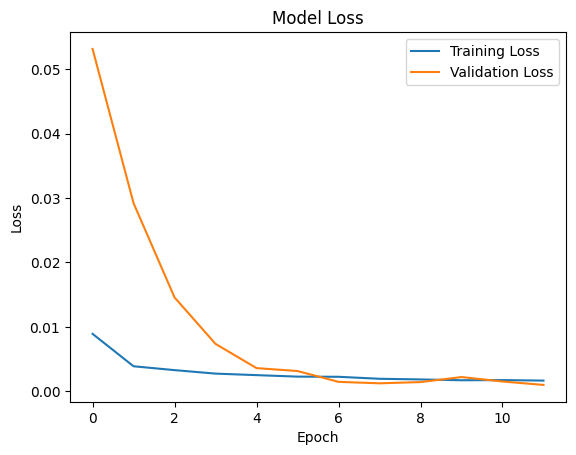

1/1 [==============================] - 0s 228ms/step - loss: 9.7790e-04 - SSIMLoss: 0.0512
Test Loss: [0.0009778998792171478, 0.05115079879760742]
1/1 [==============================] - 0s 42ms/step


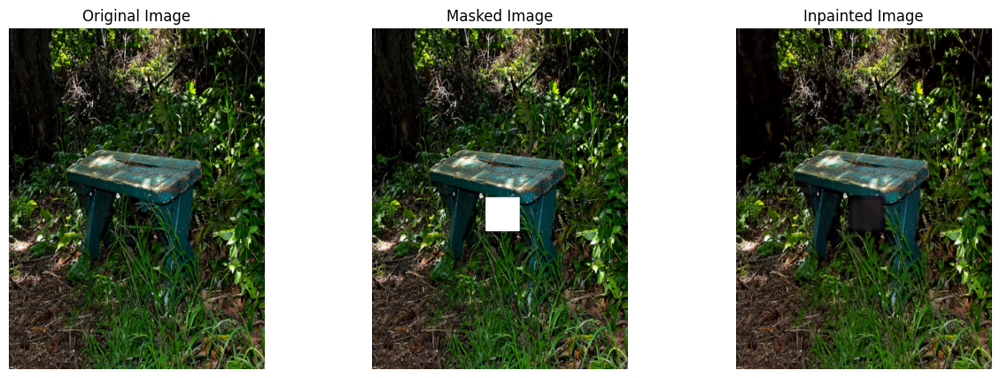

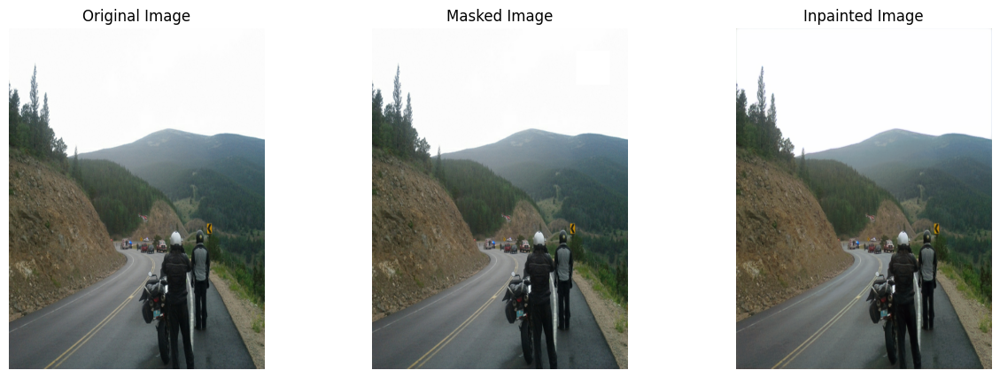

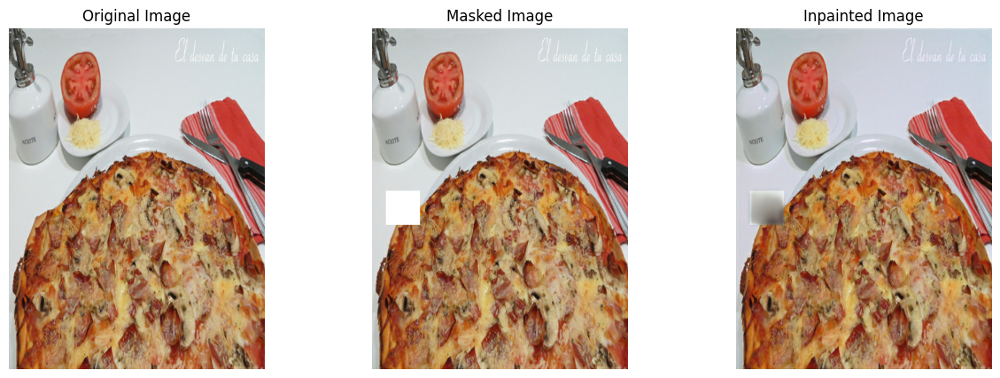

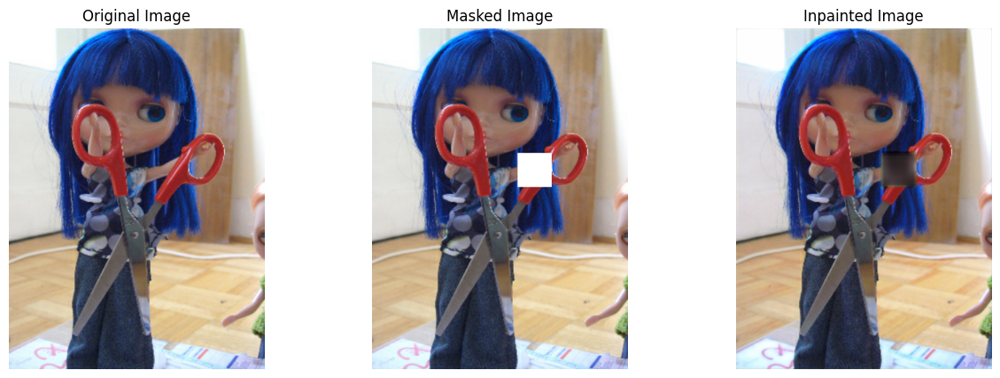

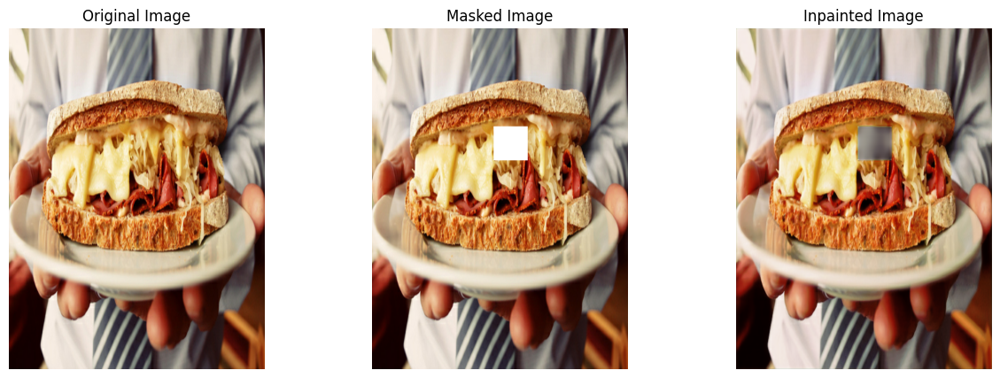

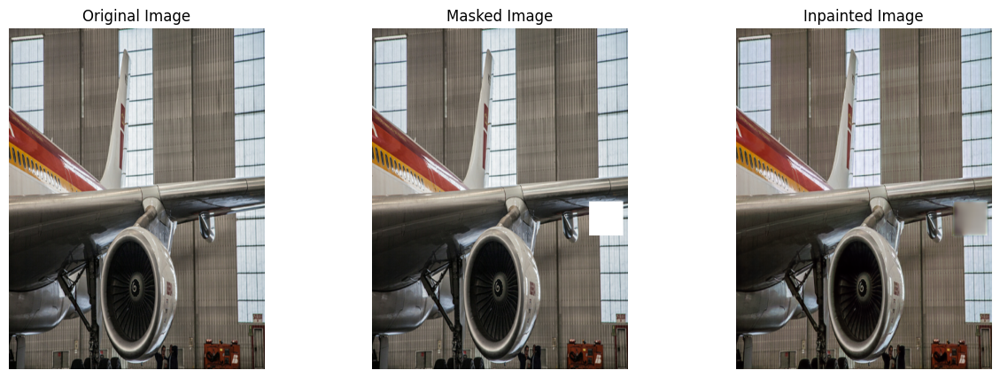

In [1]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/val2017'
test_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='adam', loss='mse', metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=12,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# SSIMLOSS + ADAM

REPLICAS:  1
1/1 [==============================] - 1s 533ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/12
125/125 [==============================] - 103s 685ms/step - loss: 0.1368 - SSIMLoss: 0.1368 - val_loss: 0.6195 - val_SSIMLoss: 0.6195
Epoch 2/12
125/125 [==============================] - 85s 680ms/step - loss: 0.0713 - SSIMLoss: 0.0713 - val_loss: 0.2664 - val_SSIMLoss: 0.2664
Epoch 3/12
125/125 [==============================] - 85s 679ms/step - loss: 0.0627 - SSIMLoss: 0.0627 - val_loss: 0.1400 - val_SSIMLoss: 0.1400
Epoch 4/12
125/125 [==============================] - 84s 677ms/step - loss: 0.0575 - SSIMLoss: 0.0575 - val_loss: 0.0706 - val_SSIMLoss: 0.0706
Epoch 5/12
125/125 [==============================] - 73s 581ms/step - loss: 0.0549 - SSIMLoss: 0.0549 - val_loss: 0.6320 - val_SSIMLoss: 0.6320
Epoch 6/12
125/125 [==============================] - 89s 712ms/step - loss: 0.0528 - SSIMLoss: 0.0528 - val_loss: 0.0689 - val_SSIMLoss

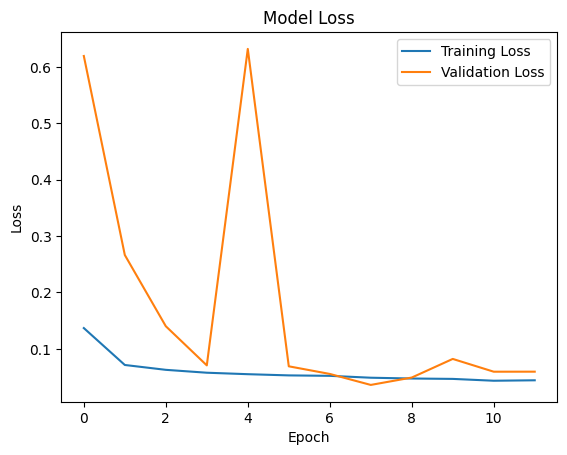

1/1 [==============================] - 0s 233ms/step - loss: 0.0734 - SSIMLoss: 0.0734
Test Loss: [0.07341200113296509, 0.07341200113296509]
1/1 [==============================] - 0s 47ms/step


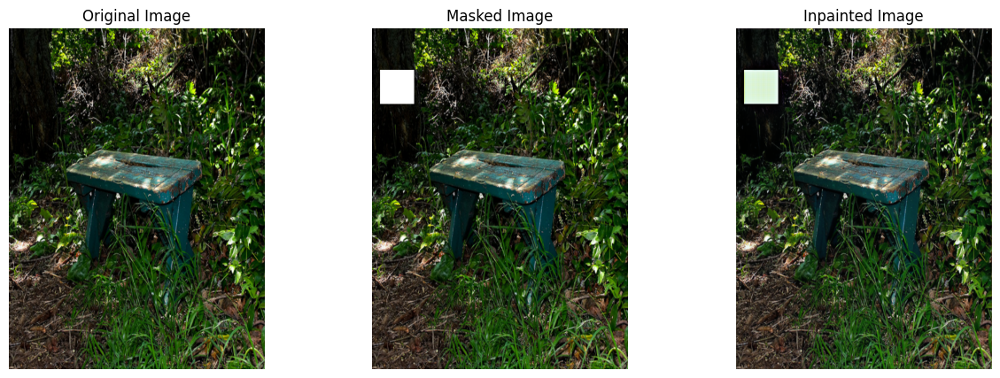

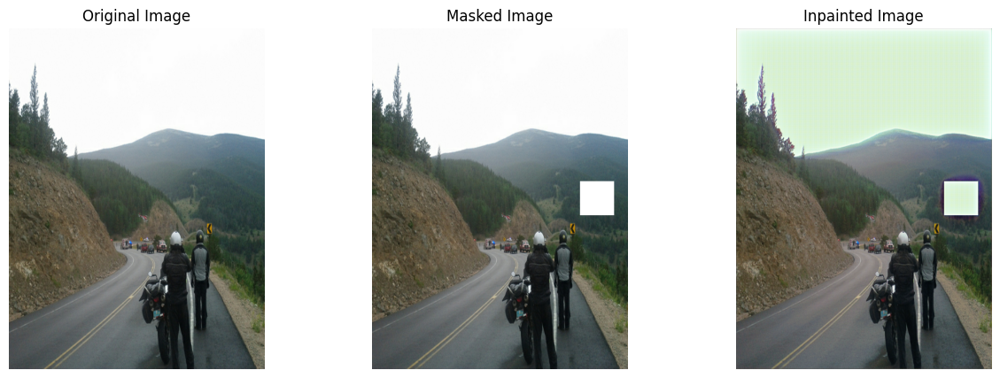

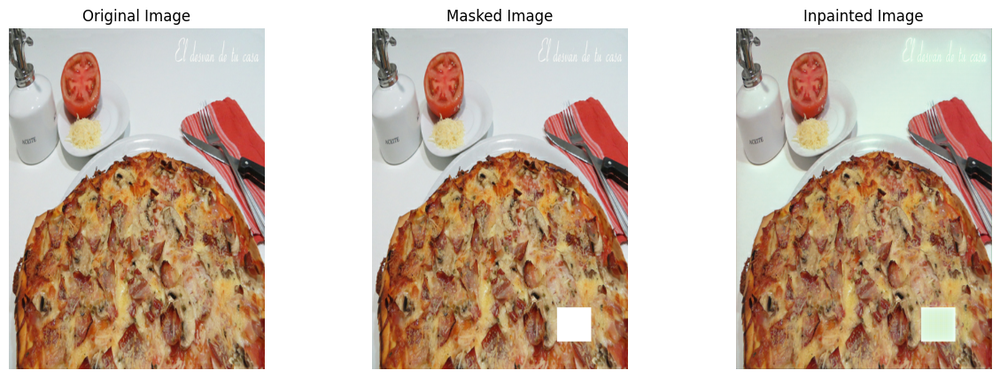

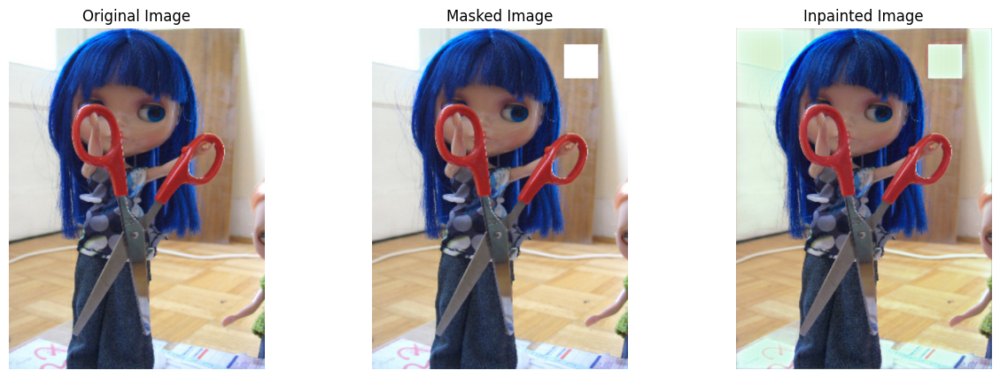

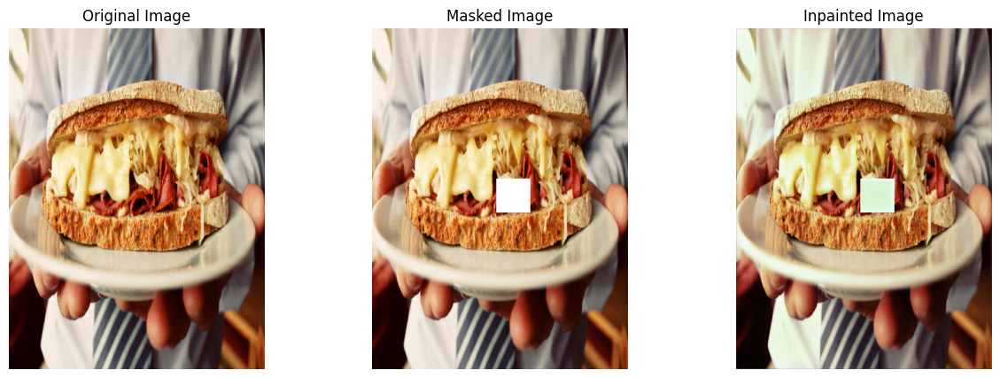

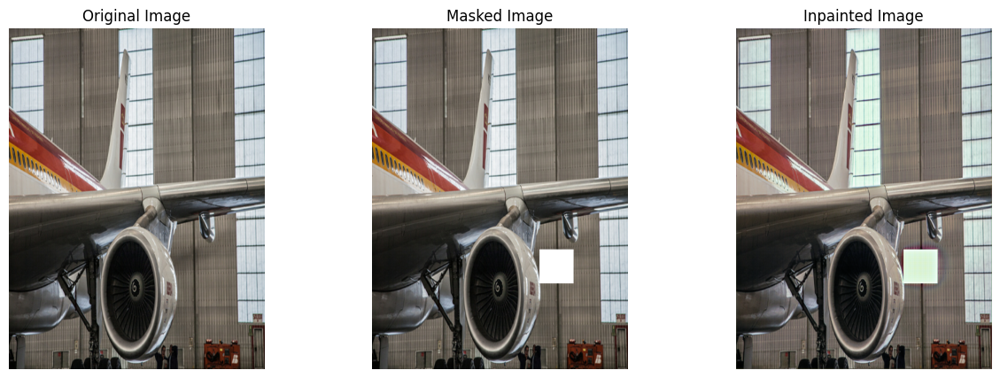

In [2]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/val2017'
test_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='adam', loss=SSIMLoss, metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=12,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# MAE + ADAM

REPLICAS:  1
1/1 [==============================] - 1s 542ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/12
125/125 [==============================] - 97s 635ms/step - loss: 0.0620 - SSIMLoss: 0.2237 - val_loss: 0.1932 - val_SSIMLoss: 0.4916
Epoch 2/12
125/125 [==============================] - 79s 634ms/step - loss: 0.0474 - SSIMLoss: 0.1182 - val_loss: 0.1569 - val_SSIMLoss: 0.3818
Epoch 3/12
125/125 [==============================] - 79s 631ms/step - loss: 0.0436 - SSIMLoss: 0.1033 - val_loss: 0.0989 - val_SSIMLoss: 0.2283
Epoch 4/12
125/125 [==============================] - 79s 634ms/step - loss: 0.0414 - SSIMLoss: 0.0966 - val_loss: 0.0558 - val_SSIMLoss: 0.1258
Epoch 5/12
125/125 [==============================] - 79s 633ms/step - loss: 0.0394 - SSIMLoss: 0.0937 - val_loss: 0.0341 - val_SSIMLoss: 0.0731
Epoch 6/12
125/125 [==============================] - 79s 633ms/step - loss: 0.0371 - SSIMLoss: 0.0904 - val_loss: 0.0298 - val_SSIMLoss:

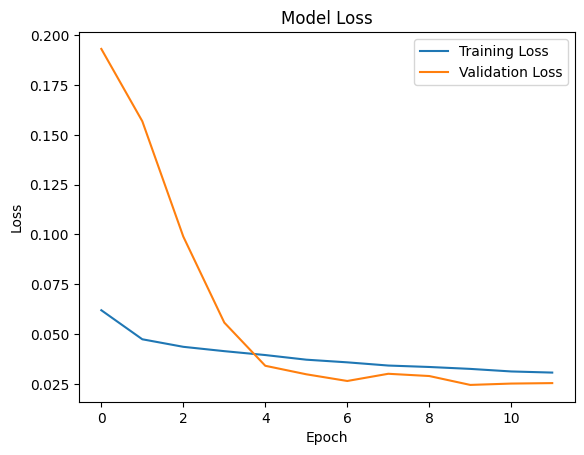

1/1 [==============================] - 0s 210ms/step - loss: 0.0244 - SSIMLoss: 0.0819
Test Loss: [0.024369431659579277, 0.08190751075744629]
1/1 [==============================] - 0s 48ms/step


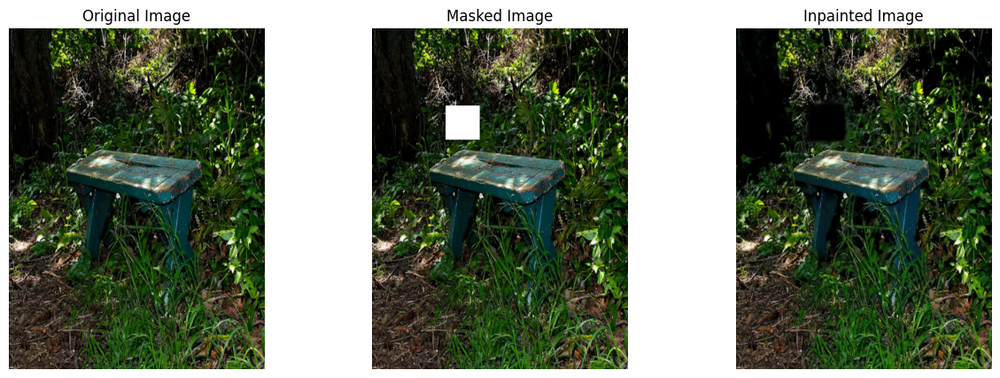

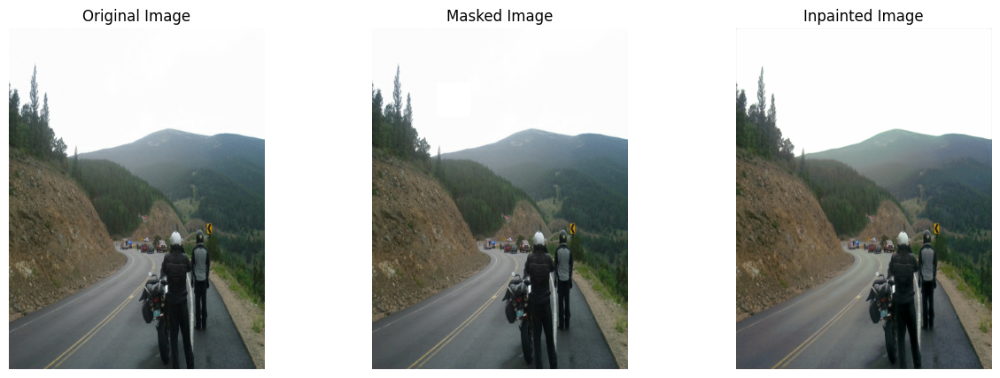

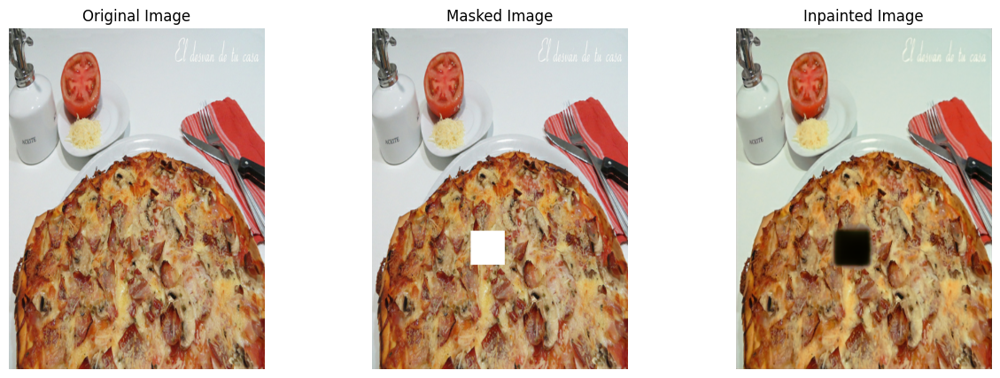

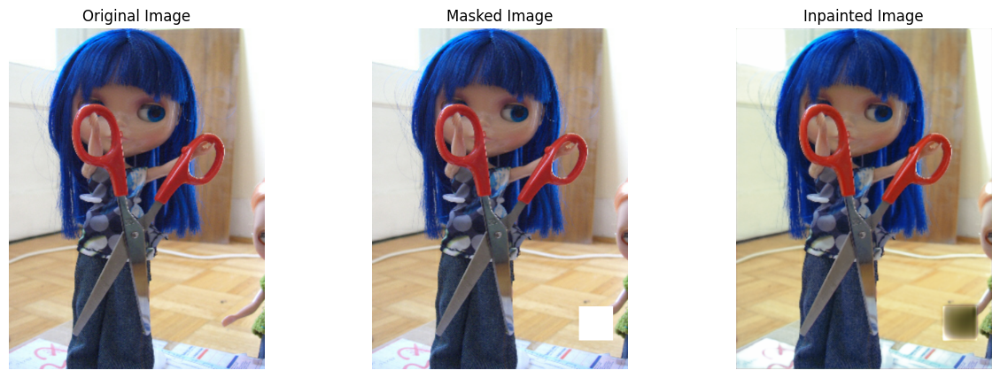

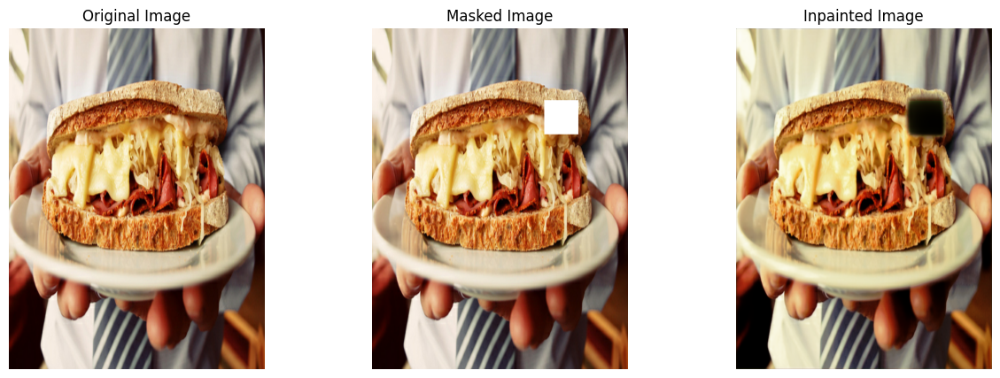

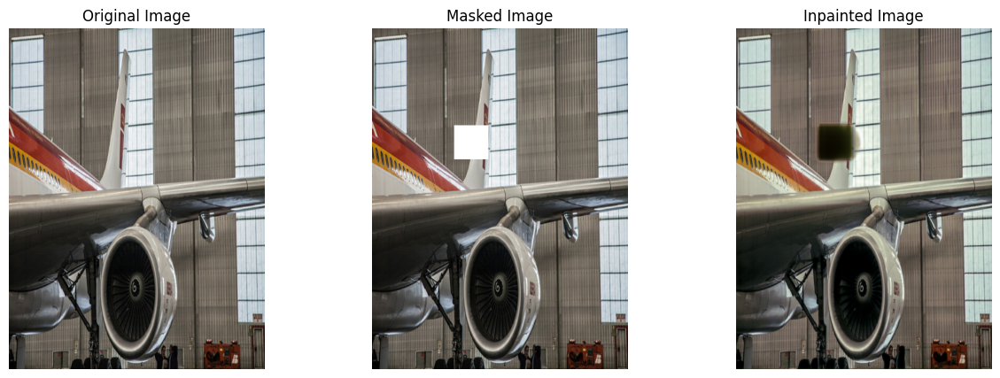

In [3]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/val2017'
test_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='adam', loss='mae', metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=12,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# MSE + RMSPROP 

REPLICAS:  1
1/1 [==============================] - 1s 550ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/12
125/125 [==============================] - 92s 633ms/step - loss: 0.0096 - SSIMLoss: 0.2716 - val_loss: 0.0497 - val_SSIMLoss: 0.4836
Epoch 2/12
125/125 [==============================] - 78s 623ms/step - loss: 0.0044 - SSIMLoss: 0.1499 - val_loss: 0.0291 - val_SSIMLoss: 0.3760
Epoch 3/12
125/125 [==============================] - 82s 656ms/step - loss: 0.0038 - SSIMLoss: 0.1283 - val_loss: 0.0128 - val_SSIMLoss: 0.2361
Epoch 4/12
125/125 [==============================] - 78s 627ms/step - loss: 0.0035 - SSIMLoss: 0.1173 - val_loss: 0.0057 - val_SSIMLoss: 0.1337
Epoch 5/12
125/125 [==============================] - 78s 625ms/step - loss: 0.0032 - SSIMLoss: 0.1110 - val_loss: 0.0017 - val_SSIMLoss: 0.1032
Epoch 6/12
125/125 [==============================] - 67s 534ms/step - loss: 0.0030 - SSIMLoss: 0.1066 - val_loss: 0.0022 - val_SSIMLoss:

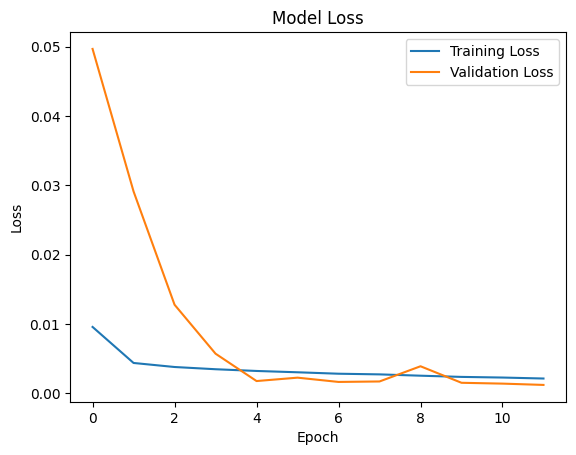

1/1 [==============================] - 0s 216ms/step - loss: 0.0012 - SSIMLoss: 0.0918
Test Loss: [0.0012338870437815785, 0.09179282188415527]
1/1 [==============================] - 0s 42ms/step


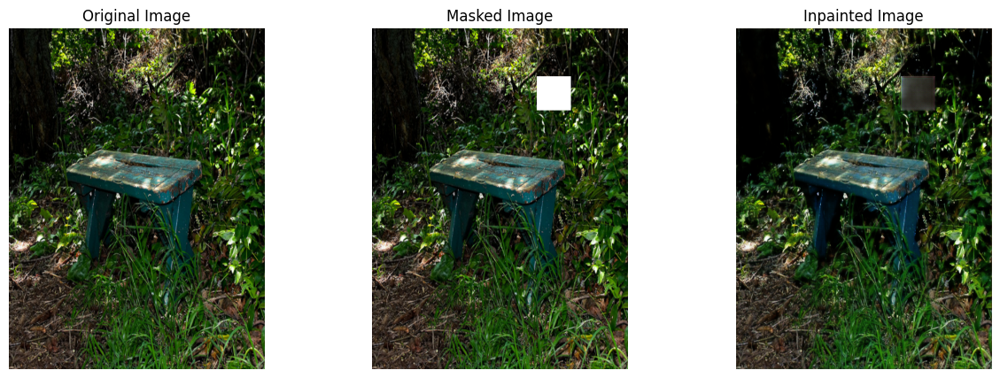

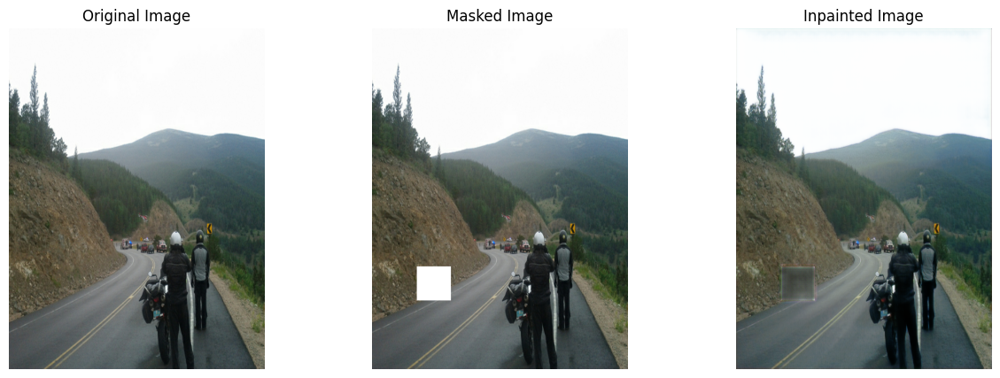

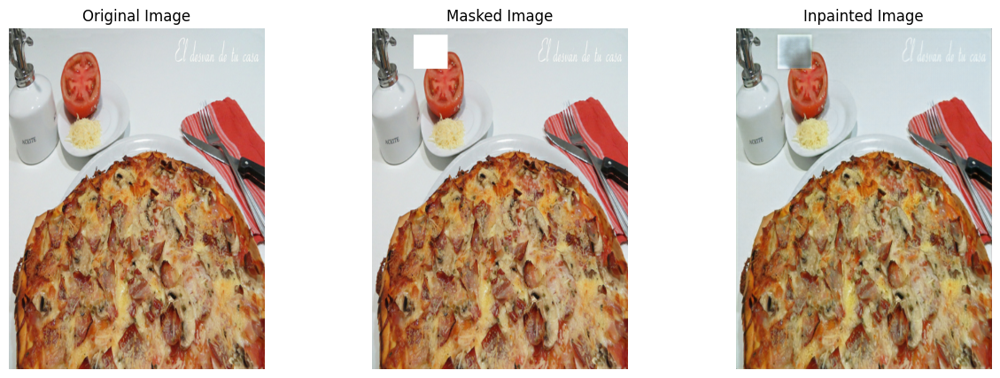

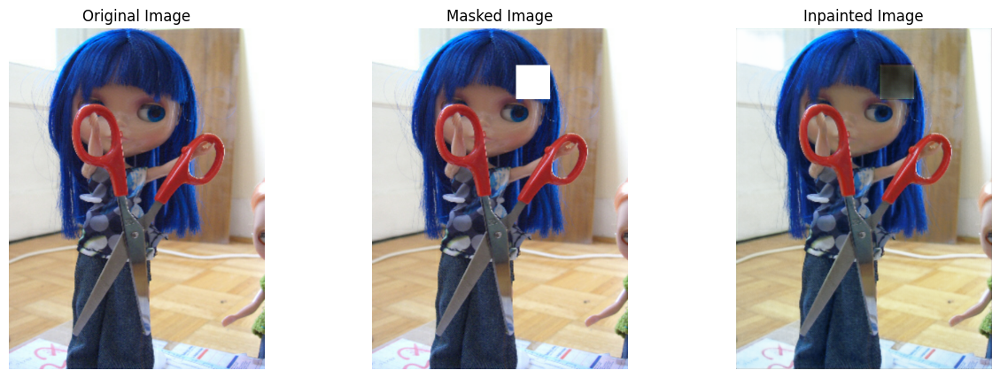

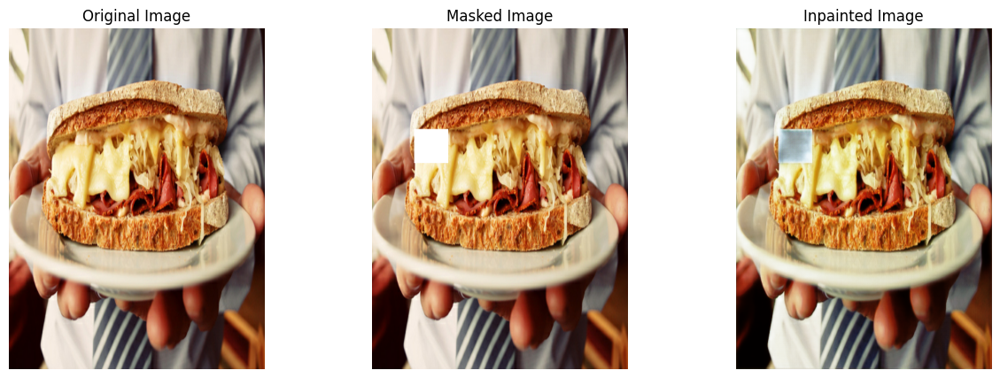

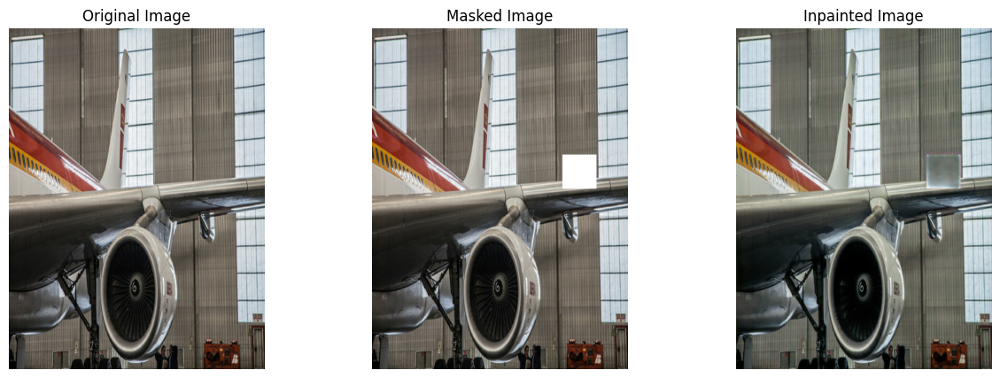

In [4]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/val2017'
test_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='rmsprop', loss='mse', metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=12,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# MAE + RMSPROP

REPLICAS:  1
1/1 [==============================] - 1s 560ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/12
125/125 [==============================] - 92s 626ms/step - loss: 0.0683 - SSIMLoss: 0.2478 - val_loss: 0.1933 - val_SSIMLoss: 0.4794
Epoch 2/12
125/125 [==============================] - 82s 656ms/step - loss: 0.0530 - SSIMLoss: 0.1309 - val_loss: 0.1441 - val_SSIMLoss: 0.3556
Epoch 3/12
125/125 [==============================] - 78s 626ms/step - loss: 0.0495 - SSIMLoss: 0.1108 - val_loss: 0.0873 - val_SSIMLoss: 0.2167
Epoch 4/12
125/125 [==============================] - 78s 628ms/step - loss: 0.0475 - SSIMLoss: 0.1017 - val_loss: 0.0409 - val_SSIMLoss: 0.1245
Epoch 5/12
125/125 [==============================] - 78s 624ms/step - loss: 0.0456 - SSIMLoss: 0.0959 - val_loss: 0.0385 - val_SSIMLoss: 0.0833
Epoch 6/12
125/125 [==============================] - 67s 534ms/step - loss: 0.0444 - SSIMLoss: 0.0917 - val_loss: 0.0450 - val_SSIMLoss:

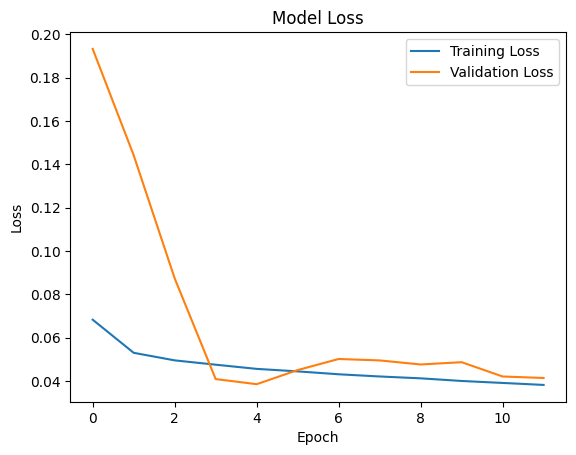

1/1 [==============================] - 0s 217ms/step - loss: 0.0431 - SSIMLoss: 0.1007
Test Loss: [0.043137189000844955, 0.10073161125183105]
1/1 [==============================] - 0s 36ms/step


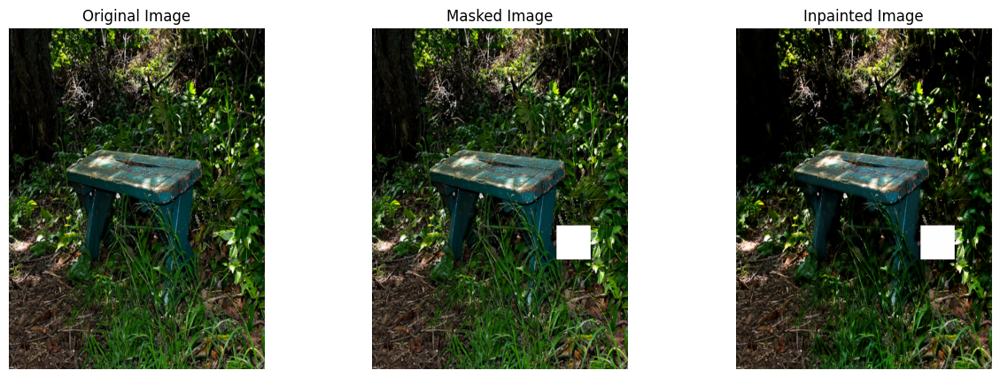

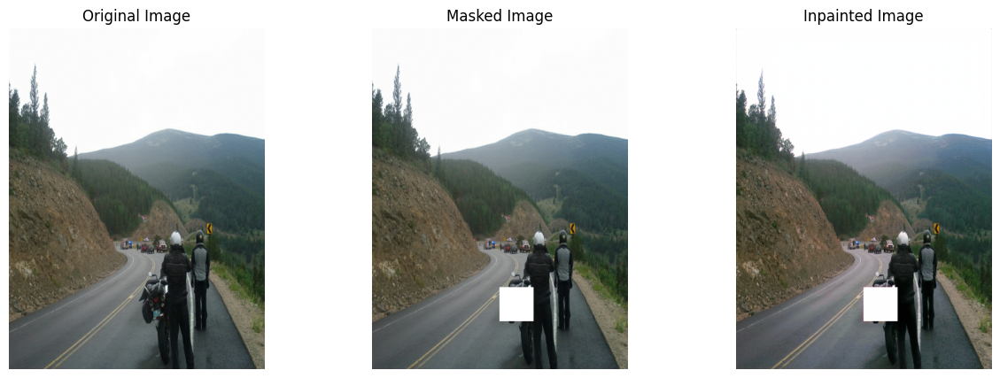

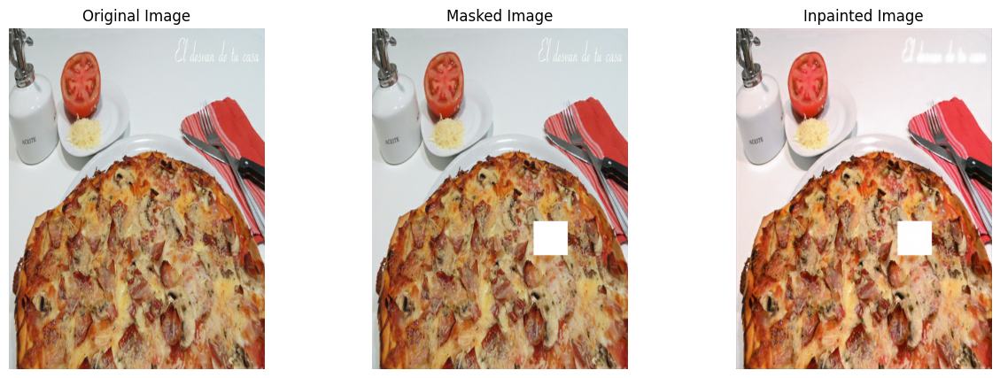

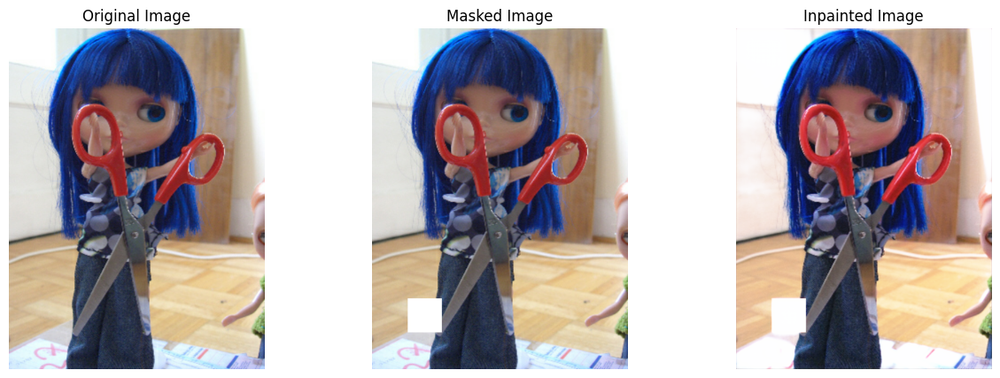

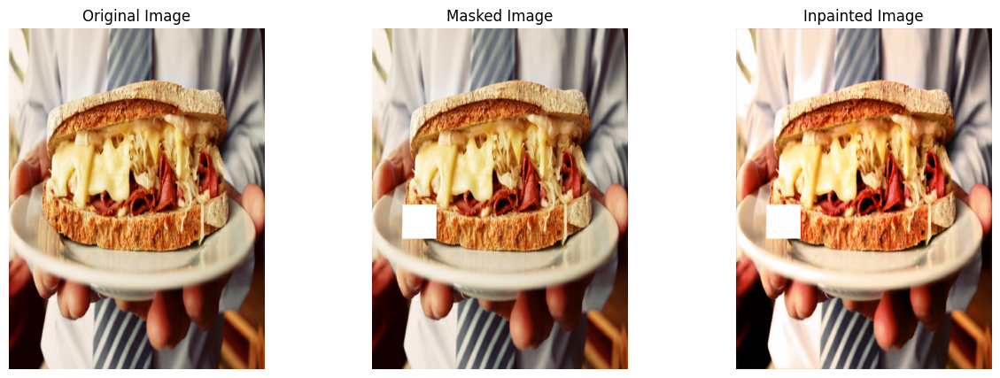

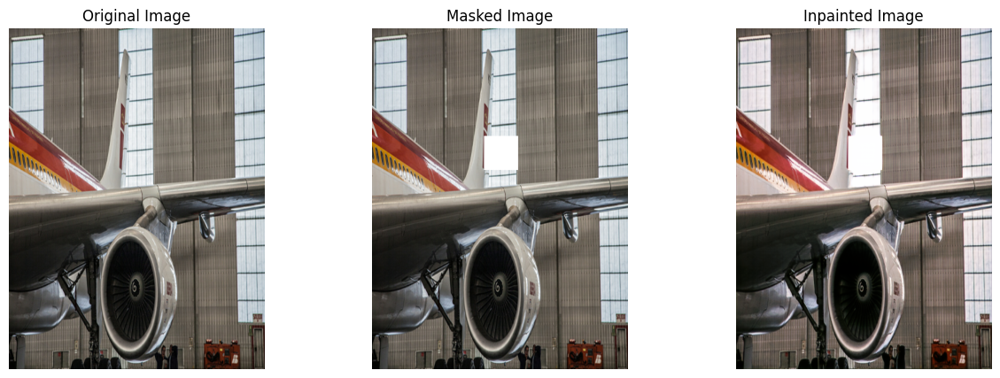

In [5]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/val2017'
test_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='rmsprop', loss='mae', metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=12,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# SSIMLOSS + RMSPROP

REPLICAS:  1
1/1 [==============================] - 1s 563ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/12
125/125 [==============================] - 98s 680ms/step - loss: 0.1229 - SSIMLoss: 0.1229 - val_loss: 0.4365 - val_SSIMLoss: 0.4365
Epoch 2/12
125/125 [==============================] - 84s 671ms/step - loss: 0.0750 - SSIMLoss: 0.0750 - val_loss: 0.2944 - val_SSIMLoss: 0.2944
Epoch 3/12
125/125 [==============================] - 84s 669ms/step - loss: 0.0674 - SSIMLoss: 0.0674 - val_loss: 0.1767 - val_SSIMLoss: 0.1767
Epoch 4/12
125/125 [==============================] - 84s 673ms/step - loss: 0.0632 - SSIMLoss: 0.0632 - val_loss: 0.0824 - val_SSIMLoss: 0.0824
Epoch 5/12
125/125 [==============================] - 84s 671ms/step - loss: 0.0599 - SSIMLoss: 0.0599 - val_loss: 0.0384 - val_SSIMLoss: 0.0384
Epoch 6/12
125/125 [==============================] - 73s 582ms/step - loss: 0.0573 - SSIMLoss: 0.0573 - val_loss: 0.0475 - val_SSIMLoss:

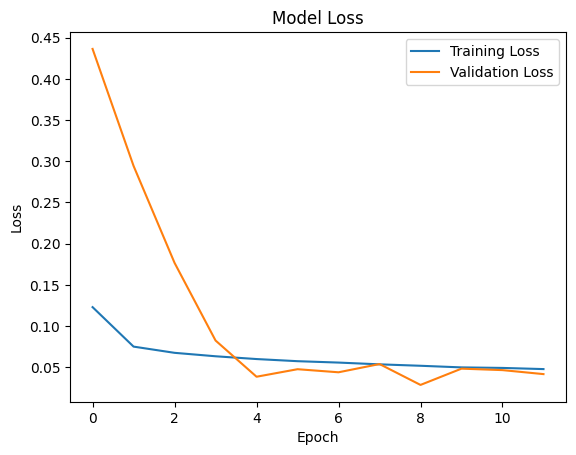

1/1 [==============================] - 0s 227ms/step - loss: 0.0413 - SSIMLoss: 0.0413
Test Loss: [0.041322946548461914, 0.041322946548461914]
1/1 [==============================] - 0s 41ms/step


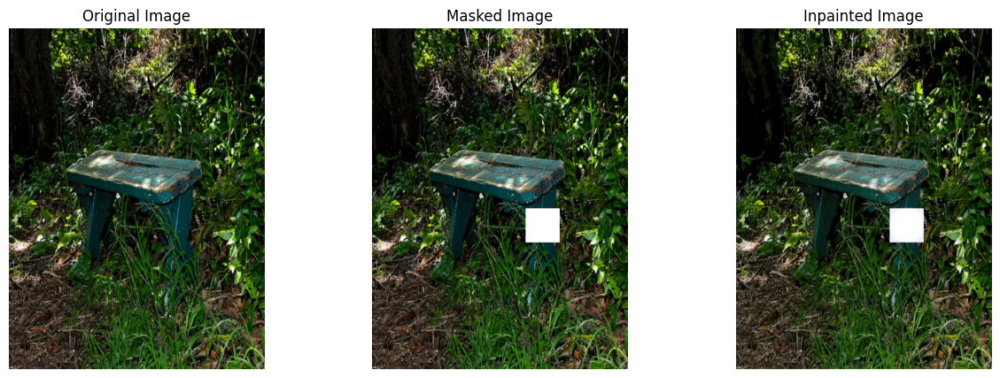

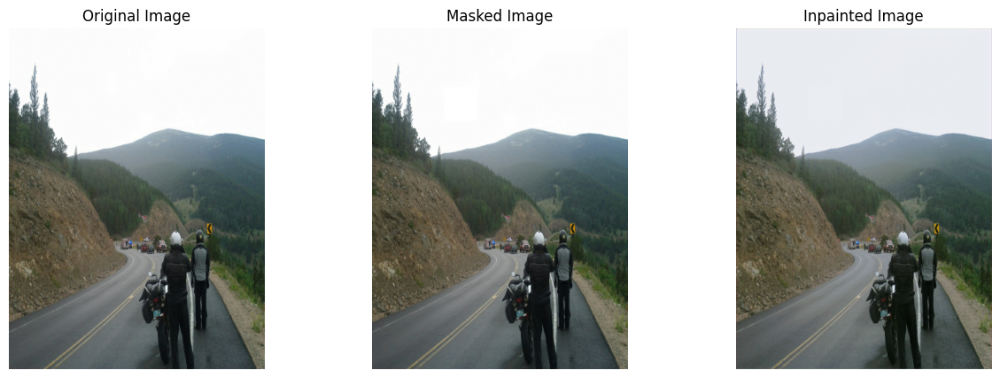

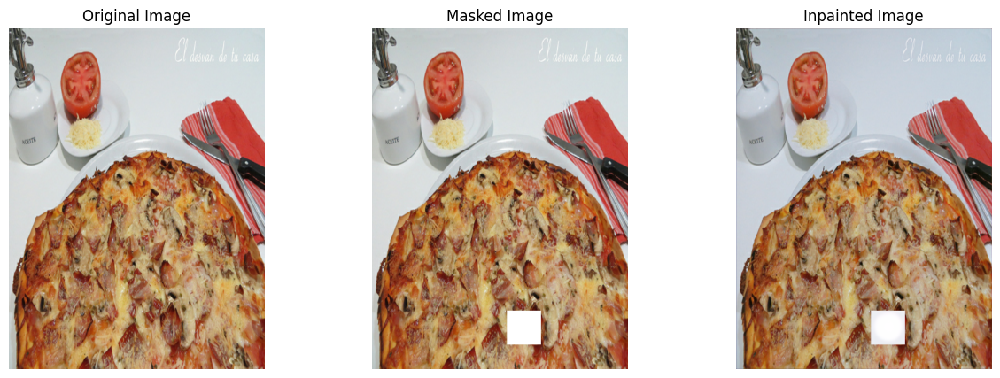

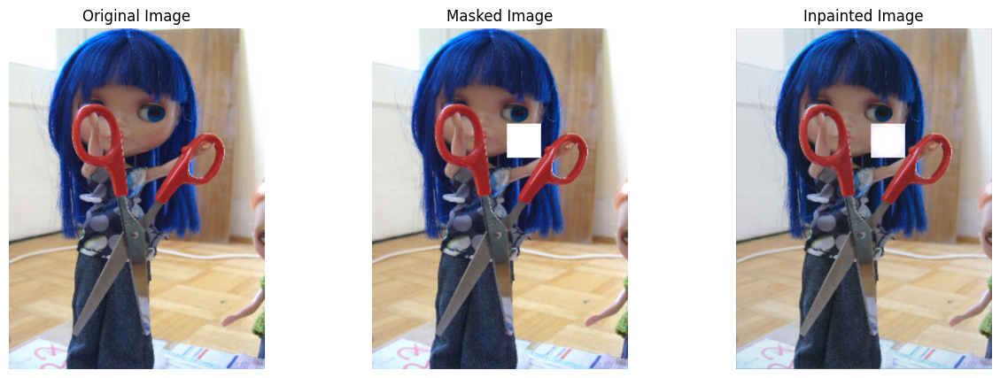

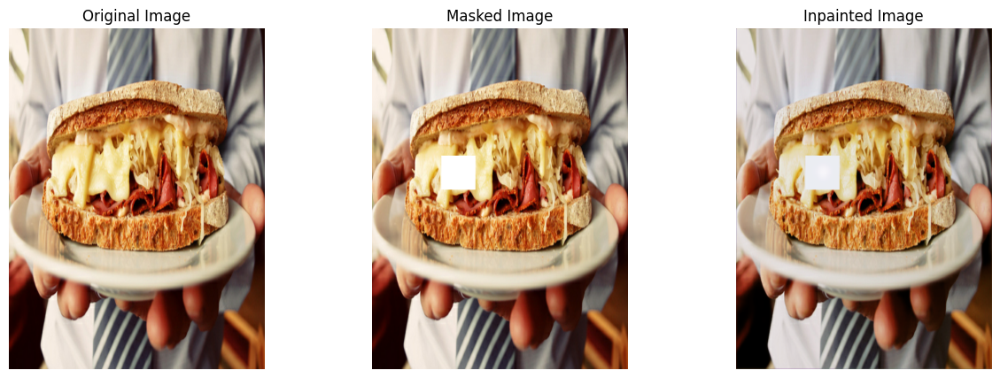

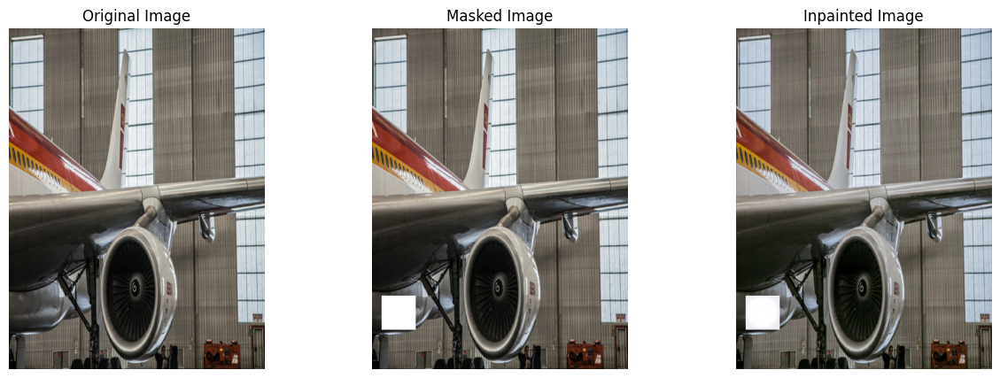

In [6]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/val2017'
test_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='rmsprop', loss=SSIMLoss, metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=12,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)

# NAJLEPSZE PODEJSCIE NA WIEKSZEJ LICZBIE EPOK:

REPLICAS:  1
1/1 [==============================] - 1s 626ms/step
Shape of dummy_output directly after model definition: (1, 640, 480, 3)
Epoch 1/40
125/125 [==============================] - 92s 631ms/step - loss: 0.0088 - SSIMLoss: 0.2840 - val_loss: 0.0518 - val_SSIMLoss: 0.4931
Epoch 2/40
125/125 [==============================] - 78s 625ms/step - loss: 0.0042 - SSIMLoss: 0.1588 - val_loss: 0.0305 - val_SSIMLoss: 0.3792
Epoch 3/40
125/125 [==============================] - 78s 625ms/step - loss: 0.0037 - SSIMLoss: 0.1344 - val_loss: 0.0150 - val_SSIMLoss: 0.2569
Epoch 4/40
125/125 [==============================] - 78s 625ms/step - loss: 0.0034 - SSIMLoss: 0.1232 - val_loss: 0.0071 - val_SSIMLoss: 0.1466
Epoch 5/40
125/125 [==============================] - 78s 628ms/step - loss: 0.0032 - SSIMLoss: 0.1163 - val_loss: 0.0040 - val_SSIMLoss: 0.0897
Epoch 6/40
125/125 [==============================] - 78s 625ms/step - loss: 0.0030 - SSIMLoss: 0.1114 - val_loss: 0.0029 - val_SSIMLoss:

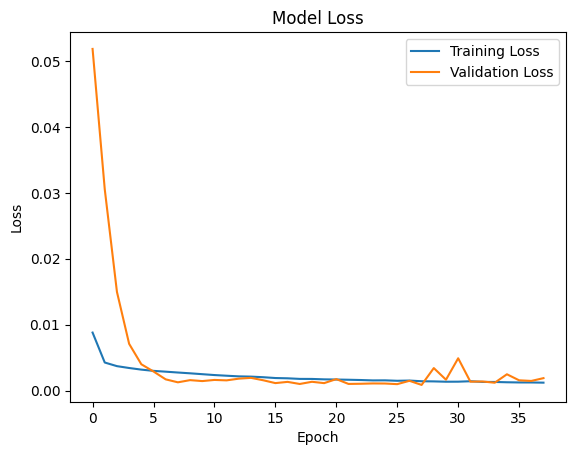

1/1 [==============================] - 0s 204ms/step - loss: 8.0339e-04 - SSIMLoss: 0.0631
Test Loss: [0.0008033910416997969, 0.06311643123626709]
1/1 [==============================] - 0s 40ms/step


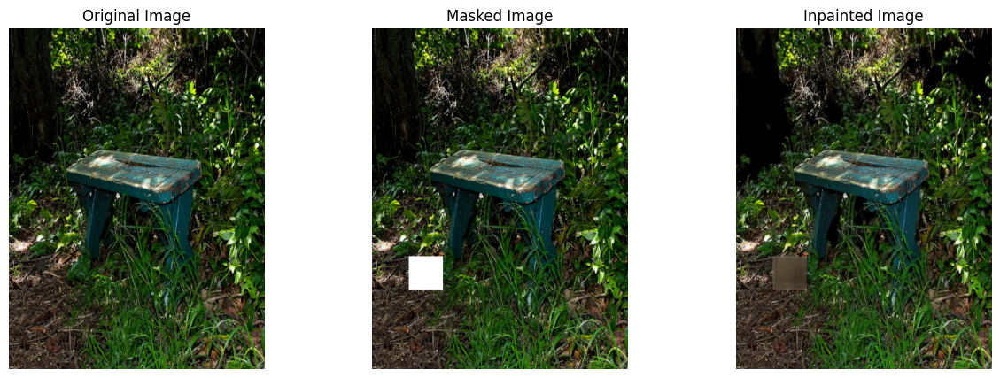

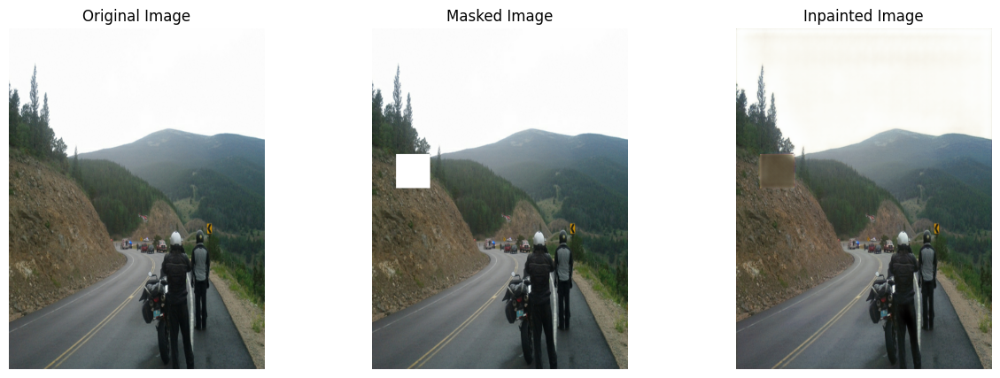

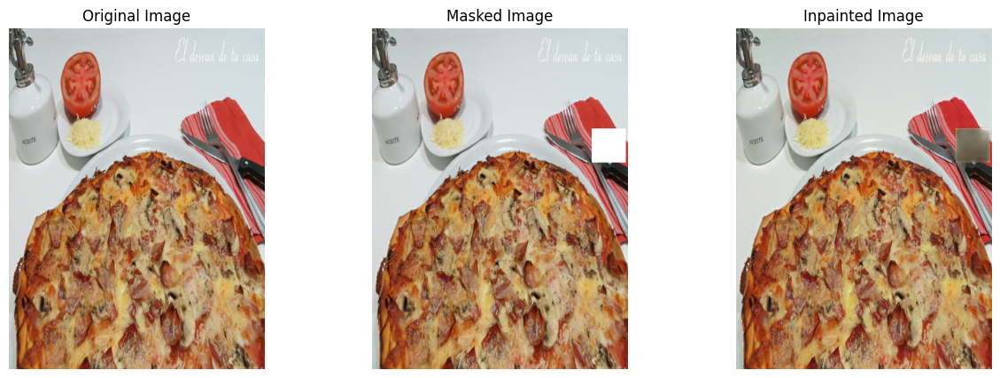

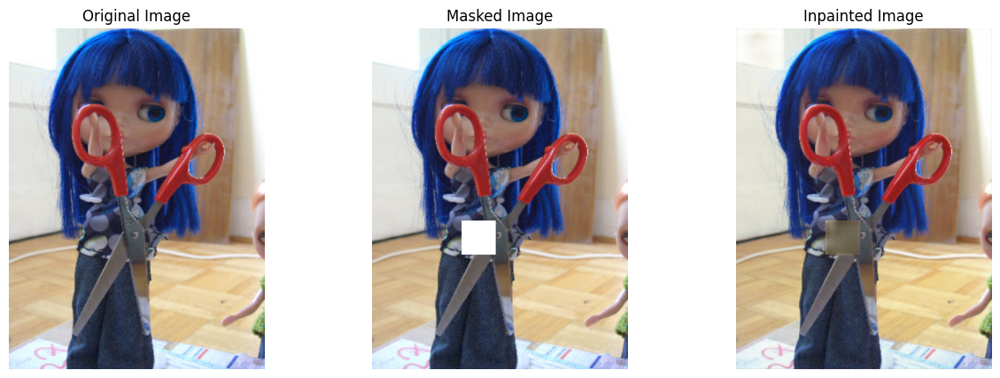

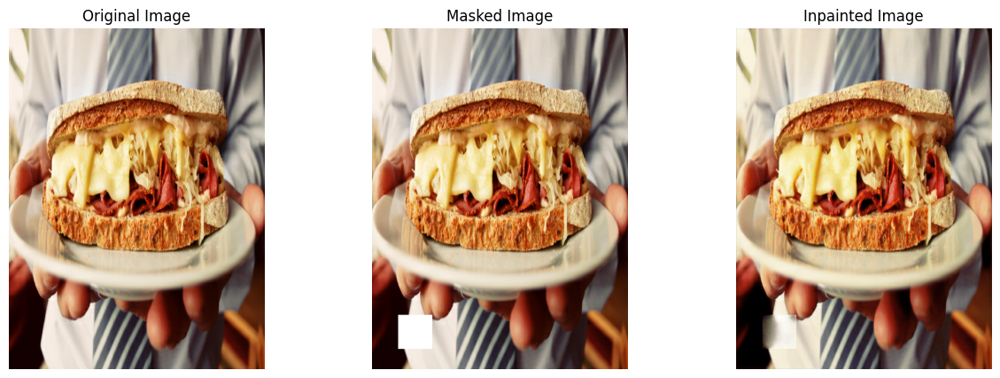

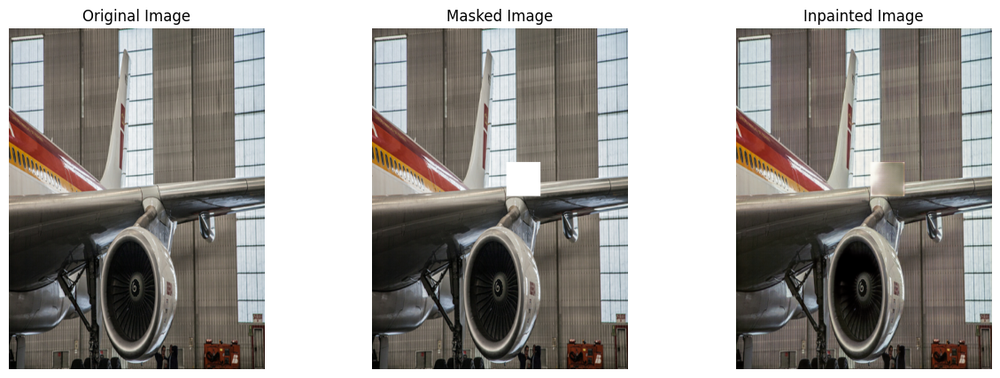

In [7]:
import os
import random
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from keras import backend as K

import matplotlib.pyplot as plt
import numpy as np

from skimage import metrics


def conv_block(input_tensor, num_filters):
    """Function for a convolutional block with BatchNormalization and ReLU activation"""
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(input_tensor)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    encoder = layers.Conv2D(num_filters, (3, 3), padding='same')(encoder)
    encoder = layers.BatchNormalization()(encoder)
    encoder = layers.Activation('relu')(encoder)
    return encoder

def encoder_block(input_tensor, num_filters):
    """Function for the encoder block"""
    encoder = conv_block(input_tensor, num_filters)
    encoder_pool = layers.MaxPooling2D((2, 2), strides=(2, 2))(encoder)
    return encoder_pool, encoder

def decoder_block(input_tensor, concat_tensor, num_filters):
    """Function for the decoder block"""
    decoder = layers.Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding='same')(input_tensor)
    decoder = layers.concatenate([concat_tensor, decoder], axis=-1)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    decoder = layers.Conv2D(num_filters, (3, 3), padding='same')(decoder)
    decoder = layers.BatchNormalization()(decoder)
    decoder = layers.Activation('relu')(decoder)
    return decoder

def unet_complex(input_size):
    inputs = tf.keras.Input(shape=input_size)

    # Encoding path
    encoder0_pool, encoder0 = encoder_block(inputs, 32)
    encoder1_pool, encoder1 = encoder_block(encoder0_pool, 64)
    encoder2_pool, encoder2 = encoder_block(encoder1_pool, 128)
    encoder3_pool, encoder3 = encoder_block(encoder2_pool, 256)
    encoder4_pool, encoder4 = encoder_block(encoder3_pool, 512)

    # Bottleneck
    center = conv_block(encoder4_pool, 1024)

    # Decoding path
    decoder4 = decoder_block(center, encoder4, 512)
    decoder3 = decoder_block(decoder4, encoder3, 256)
    decoder2 = decoder_block(decoder3, encoder2, 128)
    decoder1 = decoder_block(decoder2, encoder1, 64)
    decoder0 = decoder_block(decoder1, encoder0, 32)

    # Output layer
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(decoder0)  # Adjusted the output layer

    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model



# Detect hardware, return appropriate distribution strategy
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
    print('Running on TPU ', tpu.master())
except ValueError:
    tpu = None

if tpu:
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
    strategy = tf.distribute.get_strategy()  # default strategy that works on CPU and single GPU

print("REPLICAS: ", strategy.num_replicas_in_sync)

class InpaintingDataGenerator:
    def __init__(self, image_dir, batch_size, num_samples=None, mask_size=(64, 64), target_size=(256, 256)):
        self.image_dir = image_dir
        self.image_names = os.listdir(image_dir)
        self.batch_size = batch_size
        self.mask_size = mask_size
        self.target_size = target_size
        if num_samples is not None and num_samples < len(self.image_names):
            self.image_names = random.sample(self.image_names, num_samples)
        self.dataset = self.create_dataset()
    
    def create_dataset(self):
        # Create a dataset of file paths
        path_dataset = tf.data.Dataset.from_tensor_slices(self.image_names)

        # Map the file paths to images, masks, and masked images
        image_dataset = path_dataset.map(
            lambda x: self.load_and_preprocess_image(
                self.image_dir, tf.strings.split(x, os.sep)[-1]  # Pass directory and filename separately
            ), 
            num_parallel_calls=tf.data.AUTOTUNE
        )

        # Unpack the tuple into separate elements
        image_dataset = image_dataset.map(lambda x, y: (x, y))

        # Batch and prefetch
        image_dataset = image_dataset.batch(self.batch_size)
        image_dataset = image_dataset.prefetch(buffer_size=tf.data.AUTOTUNE)

        return image_dataset
    
    def load_and_preprocess_image(self, dir_path, filename):
        # Combine the directory and filename to get the full path to the image
        img_path = tf.strings.join([dir_path, filename], separator='/')
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.convert_image_dtype(img, tf.float32)
        img = tf.image.resize(img, self.target_size)
        # Create mask
        img_size = tf.shape(img)[:2]
        mask = tf.zeros((img_size[0], img_size[1], 1), dtype=tf.float32)
        top_left_x = tf.random.uniform((), 0, img_size[0] - self.mask_size[0], dtype=tf.int32)
        top_left_y = tf.random.uniform((), 0, img_size[1] - self.mask_size[1], dtype=tf.int32)
        bottom_right_x = top_left_x + self.mask_size[0]
        bottom_right_y = top_left_y + self.mask_size[1]

        # Generate indices for the mask
        indices = tf.reshape(
            tf.stack(
                tf.meshgrid(
                    tf.range(top_left_x, bottom_right_x),
                    tf.range(top_left_y, bottom_right_y),
                    indexing='ij'
                ),
                axis=-1
            ),
            (-1, 2)
        )
    
        # Create updates for the mask
        updates = tf.ones((self.mask_size[0] * self.mask_size[1], 1), dtype=tf.float32)

        # Update the mask tensor
        mask = tf.tensor_scatter_nd_update(mask, indices, updates)

        # Apply mask
        masked_img = img * (1 - mask) + mask

        # Return a tuple of two elements:
        # 1. the masked image (input to the model)
        # 2. the original image (ground truth for training)
        return masked_img, img

# Define directory paths and batch size
train_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/train2017'
val_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/val2017'
test_image_dir = '/kaggle/input/coco-2017-dataset/coco2017/test2017'
batch_size = 8 * strategy.num_replicas_in_sync  # Adjust batch size based on the number of TPU cores

    
# Initialize data generators
train_generator = InpaintingDataGenerator(train_image_dir, batch_size, num_samples=1000, target_size=(640, 480))
val_generator = InpaintingDataGenerator(val_image_dir, batch_size, target_size=(640, 480))
test_generator = InpaintingDataGenerator(test_image_dir, batch_size, target_size=(640, 480))

# losses
# check also mae i msa
# save all of the models for comparison
def SSIMLoss(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, 1.0))

def PSNR(y_true, y_pred):
    max_pixel = 1.0
    return (10.0 * K.log((max_pixel ** 2) / (K.mean(K.square(y_pred - y_true), axis=-1)))) / 2.303


# Initialize the complex U-Net model within the TPU strategy scope
with strategy.scope():
    final_model = unet_complex(input_size=(640, 480, 3))
    # It's crucial to compile the model within the strategy scope.
    final_model.compile(optimizer='rmsprop', loss='mse', metrics=[SSIMLoss])

    # After compiling, make a dummy prediction to check the output shape.
    dummy_input = tf.random.normal((1, 640, 480, 3))
    dummy_output = final_model.predict(dummy_input)
    print("Shape of dummy_output directly after model definition:", dummy_output.shape)

# Initialize callbacks
callbacks = [
    ModelCheckpoint('best_inpainting_model.tf', monitor='val_loss', save_best_only=True),
    EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
]


# Train the model
history = final_model.fit(
    train_generator.dataset,
    epochs=40,  # Training for 3 epochs as an example
    steps_per_epoch=min(1000, len(train_generator.image_names)) // batch_size,
    validation_data=val_generator.dataset,
    validation_steps=min(300, len(val_generator.image_names)) // batch_size,
    callbacks=callbacks
)


# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()
plt.show()

# # Evaluate on test set
# test_loss = final_model.evaluate(
#     test_generator.dataset,
#     steps=len(test_generator.image_names) // batch_size
# )

# Evaluate on test set
for sample in test_generator.dataset.take(1):
    masked_images, original_images = sample
    test_loss = final_model.evaluate(masked_images, original_images)
    print(f'Test Loss: {test_loss}')

# Display inpainting results
def display_inpainting_results(model, generator, num_samples=3):
    # Take one batch from the dataset
    for sample in generator.dataset.take(1):
        masked_images, original_images = sample

        # Predict inpainted images
        inpainted_images = model.predict(masked_images)

        # Display the results for the specified number of samples
        for i in range(min(num_samples, masked_images.shape[0])):
            plt.figure(figsize=(15, 5))
            
            # Display original image
            plt.subplot(1, 3, 1)
            plt.imshow(original_images[i].numpy() if isinstance(original_images[i], tf.Tensor) else original_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Original Image')
            plt.axis('off')
            
            # Display masked image
            plt.subplot(1, 3, 2)
            plt.imshow(masked_images[i].numpy() if isinstance(masked_images[i], tf.Tensor) else masked_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Masked Image')
            plt.axis('off')
            
            # Display inpainted image
            plt.subplot(1, 3, 3)
            plt.imshow(inpainted_images[i].numpy() if isinstance(inpainted_images[i], tf.Tensor) else inpainted_images[i])  # Convert TensorFlow tensor to NumPy array if needed
            plt.title('Inpainted Image')
            plt.axis('off')
            plt.show()

display_inpainting_results(final_model, test_generator, num_samples=6)